# Written By: Rupesh Kumar Dey
# Project Title: Deep Learning Based GI Tract Disease Classification By Analysing WCE Imaging
# Notebook Title: Exploratory Data Analysis (Image Processed Images)

Python Notebook to Explore and study the characteristics of the Image Processed data

In [1]:
# Import required libraries
import os
import pandas as pd
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
import PIL
from PIL import Image
import cv2
import seaborn as sns

In [2]:
project_folder = "C:\\Users\\User\\Documents\\Masters in AI\\GITractClassification\\"

# 1) Exploratory Data Analysis CLAHE

In [3]:
# Iterating through each folder in the project data directory
# Base path where data is stored. 
path_data = project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\"
# Walk through data directory
for dirpath, dirnames, filenames in os.walk(path_data):
    if len(filenames) > 0:
      print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")
    
# Analysis shows that the quanitty of images are balanced for each class
# Training image data quantity can be increased by means of data augmentation whcih will be explored further 

There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_CLAHE\train\0_normal_CLAHE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_CLAHE\train\1_ulcerative_colitis_CLAHE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_CLAHE\train\2_polyps_CLAHE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_CLAHE\train\3_esophagitis_CLAHE'.


In [4]:
# Get the class names (programmatically, this is much more helpful with a longer list of classes)
data_dir = pathlib.Path(path_data) # turn our training path into a Python path
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectories
print("4 Major Classes are:")
print(class_names)

4 Major Classes are:
['0_normal_CLAHE' '1_ulcerative_colitis_CLAHE' '2_polyps_CLAHE'
 '3_esophagitis_CLAHE']


In [5]:
# Function to randomly View an image from each class
def view_random_image(target_dir, target_class):
    """
    Function that plots 3 random images from a directory
    input:
        a) target_dir - folder directory where images are stored
        b) target_class - the class that you want to display the image from
    """
    # Setup target directory (we'll view images from here)
    target_folder = target_dir+target_class
    
    # Get a random image path
    random_image = random.sample(os.listdir(target_folder), 3)
    print(random_image)
    plt.figure(figsize = (30,10))
    for i in range(len(random_image)):
        # Read in the image and plot it using matplotlib
        print(random_image[i])
        img = mpimg.imread(target_folder + "/" + random_image[i])
        plt.subplot(1,3,i+1)
        plt.imshow(img)
    plt.rcParams['savefig.facecolor']='red'
    plt.title(target_class)
    
    plt.axis("off");
    plt.show()

['CLAHE_train_normal_ (366).jpg', 'CLAHE_val_normal_ (284).jpg', 'CLAHE_train_normal_ (736).jpg']
CLAHE_train_normal_ (366).jpg
CLAHE_val_normal_ (284).jpg
CLAHE_train_normal_ (736).jpg


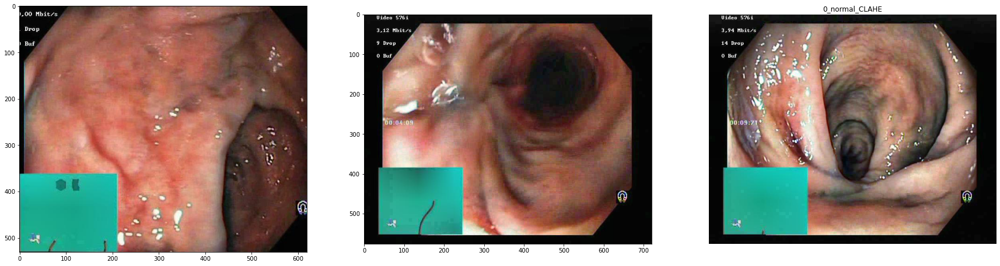

In [6]:
# Plotting images for normal class
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\","0_normal_CLAHE")

['CLAHE_train_ulcer_ (241).jpg', 'CLAHE_val_ulcer_ (283).jpg', 'CLAHE_train_ulcer_ (428).jpg']
CLAHE_train_ulcer_ (241).jpg
CLAHE_val_ulcer_ (283).jpg
CLAHE_train_ulcer_ (428).jpg


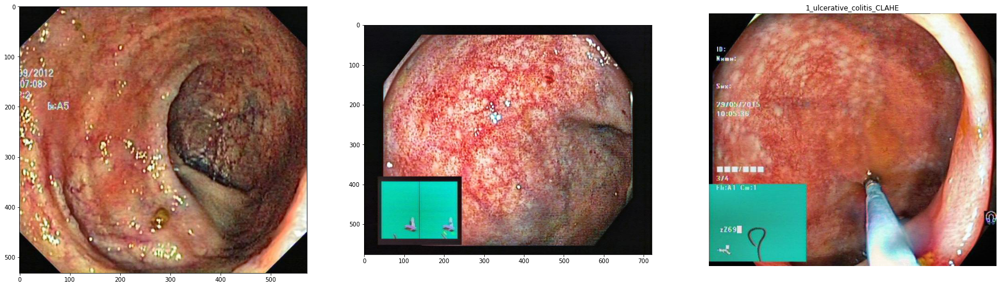

In [7]:
# Plotting images for ulcerative colitis class 
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\","1_ulcerative_colitis_CLAHE")

['CLAHE_train_polyps_ (67).jpg', 'CLAHE_train_polyps_ (799).jpg', 'CLAHE_train_polyps_ (163).jpg']
CLAHE_train_polyps_ (67).jpg
CLAHE_train_polyps_ (799).jpg
CLAHE_train_polyps_ (163).jpg


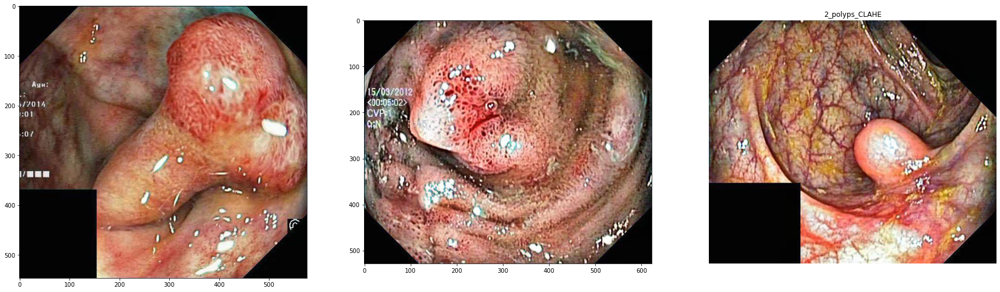

In [8]:
# Plotting images for polyps class 2_polyps
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\","2_polyps_CLAHE")

['CLAHE_train_esophagitis_ (280).jpg', 'CLAHE_train_esophagitis_ (652).jpg', 'CLAHE_train_esophagitis_ (265).jpg']
CLAHE_train_esophagitis_ (280).jpg
CLAHE_train_esophagitis_ (652).jpg
CLAHE_train_esophagitis_ (265).jpg


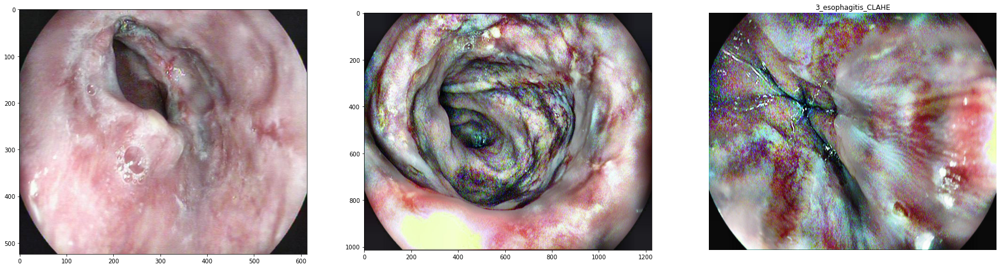

In [9]:
# Plotting images for esophagitis class 3_esophagitis
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\","3_esophagitis_CLAHE")

In [10]:
# Section to create dataframe of image parameters
# Only limited to training image data
# Now we create a .csv file with the contents / metadata from the entire training dataset. 
trainPath = project_folder + "05_Dataset\\Dataset\\Dataset_CLAHE\\train\\"
trainDir = os.listdir(trainPath)
new_df = pd.DataFrame(columns = ['image_id', 'path','class','width','height','channels','average_R','average_G','average_B','processing_method'])

# Creating the csv file
# Loop through main project directory where training image is stored, gets the image and its parameters and appends it to the df
print("Processing")
for i in range(len(trainDir)):
    listImages = os.listdir(trainPath + trainDir[i])
    for j in range(len(listImages)):
        # Read image
        imageLocation = trainPath + trainDir[i] + "\\" + listImages[j]
        tempImage = cv2.imread(imageLocation)
        tempImage = cv2.cvtColor(tempImage, cv2.COLOR_BGR2RGB)
        # Get image dimensions
        tempHeight, tempWidth, tempChannels = np.shape(tempImage)
        # Get image pixel data
        tempAverage_R = np.mean(tempImage[:,:,0])
        tempAverage_G = np.mean(tempImage[:,:,1])
        tempAverage_B = np.mean(tempImage[:,:,2])
        # Append to dataframe
        new_df = new_df.append({'image_id' : listImages[j], 'path' : trainDir[i] + "\\" + listImages[j], 
                                'class': trainDir[i],'width': tempWidth,'height': tempHeight,'channels': tempChannels,
                                'average_R': tempAverage_R,'average_G': tempAverage_G,'average_B':tempAverage_B,'processing_method' : "CLAHE"},ignore_index = True)
print("Processing Done")
# Save dataframe to project directory
# new_df.to_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_CLAHE.csv", index = False)

Processing
Processing Done


In [11]:
# Uploading csv file for analysis
df_CLAHE = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_CLAHE.csv", index_col = False)
df_CLAHE.head()

,image_id,path,class,width,height,channels,average_R,average_G,average_B,processing_method
0,CLAHE_train_normal_ (1).jpg,0_normal_CLAHE\CLAHE_train_normal_ (1).jpg,0_normal_CLAHE,615,531,3,132.980981,101.982855,87.551122,CLAHE
1,CLAHE_train_normal_ (10).jpg,0_normal_CLAHE\CLAHE_train_normal_ (10).jpg,0_normal_CLAHE,633,531,3,137.487789,107.305076,92.523588,CLAHE
2,CLAHE_train_normal_ (100).jpg,0_normal_CLAHE\CLAHE_train_normal_ (100).jpg,0_normal_CLAHE,633,532,3,139.672974,116.123552,96.402475,CLAHE
3,CLAHE_train_normal_ (101).jpg,0_normal_CLAHE\CLAHE_train_normal_ (101).jpg,0_normal_CLAHE,633,532,3,147.995017,110.622177,93.458935,CLAHE
4,CLAHE_train_normal_ (102).jpg,0_normal_CLAHE\CLAHE_train_normal_ (102).jpg,0_normal_CLAHE,633,532,3,122.093177,97.279986,83.778264,CLAHE


In [12]:
# grouping the data based on their mean, medianm,  min and max height and width parameters
df_groupedCLAHE = df_CLAHE.groupby('class').agg({'width': ['mean',"median",'min', 'max'], 'height': ['mean',"median",'min', 'max']})
df_groupedCLAHE

width                        height         \
                                   mean median  min   max        mean median   
class                                                                          
0_normal_CLAHE               686.335238    720  459   720  559.053333    576   
1_ulcerative_colitis_CLAHE   658.807619    627  482  1920  558.131429    532   
2_polyps_CLAHE               652.767619    622  332  1920  556.036190    531   
3_esophagitis_CLAHE         1256.282857   1225  613  1920  998.212381   1015   

                                       
                            min   max  
class                                  
0_normal_CLAHE              530   576  
1_ulcerative_colitis_CLAHE  447  1080  
2_polyps_CLAHE              352  1072  
3_esophagitis_CLAHE         523  1072

In [13]:
# Function to plot the data for visualizing the image size parameters
def plotHorizontalBar(y_axis, x_axis,parameterY,parameterX):
    # Figure Size
    fig, ax = plt.subplots(figsize =(10, 5))
    fig.patch.set_facecolor('xkcd:mint green')
    # Horizontal Bar Plot
    ax.barh(y_axis, x_axis)

    # Remove axes splines
    for s in ['top', 'bottom', 'left', 'right']:
        ax.spines[s].set_visible(False)

    # Remove x, y Ticks
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')

    # Add padding between axes and labels
    ax.xaxis.set_tick_params(pad = 5)
    ax.yaxis.set_tick_params(pad = 10)

    # Add x, y gridlines
    ax.grid(b = True, color ='grey',
            linestyle ='-.', linewidth = 0.5,
            alpha = 0.2)

    # Show top values
    ax.invert_yaxis()

    # Add annotation to bars
    for i in ax.patches:
        plt.text(i.get_width()+0.2, i.get_y()+0.5,
                 str(round((i.get_width()), 2)),
                 fontsize = 10, fontweight ='bold',
                 color ='grey')
    # Add Plot Title
    ax.set_title(f'Image {parameterY} and their {parameterX}',
                 loc ='center', )
    # Show Plot
    plt.show()

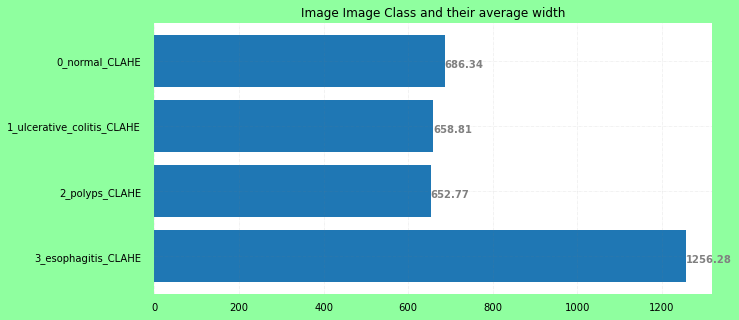

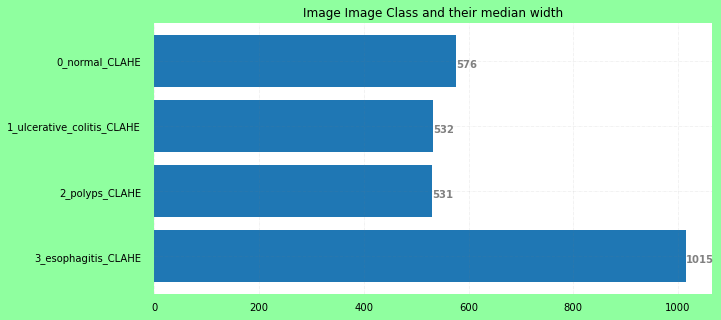

In [14]:
# # Read CSV into pandas 
classes = df_groupedCLAHE.index
avgWidth = df_groupedCLAHE['width']["mean"]
medWidth = df_groupedCLAHE['width']["median"]
avgHeight = df_groupedCLAHE['height']["mean"]
medWidth = df_groupedCLAHE['height']["median"]

plotHorizontalBar(classes,avgWidth,"Image Class","average width")
plotHorizontalBar(classes,medWidth,"Image Class","median width")
# esogophitis class has the biggest image size averaging around 1.2K in average and 1K in median.(consider average)
# Other classes have image size of around 650 on average and 550 in median (i think for this we consider the average)

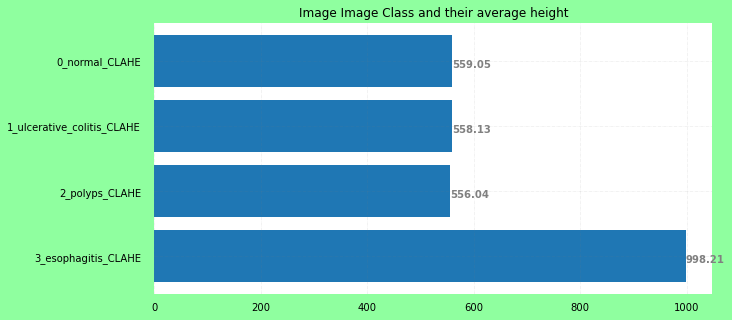

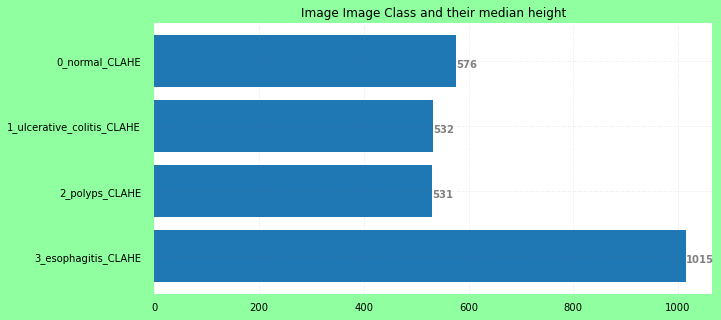

In [15]:
plotHorizontalBar(classes,avgHeight,"Image Class","average height")
plotHorizontalBar(classes,medWidth,"Image Class","median height")

# average height of esogophiotis is around 1K (average) whereas the rest circle around 550
# Median wise the esogophitis is around 1K as well with the rest being around 550

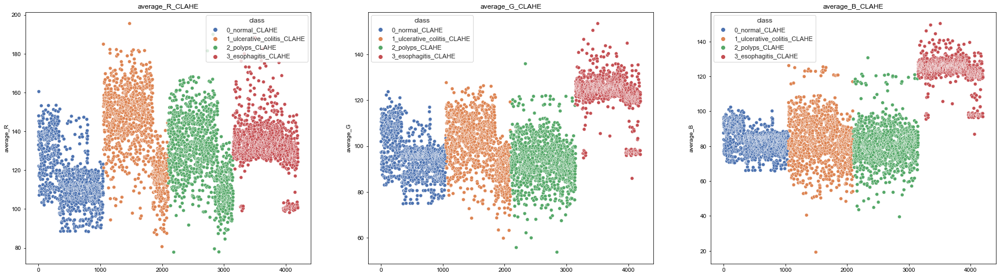

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [16]:
def scatterPlot(x,y,hue,dataset, figure, axes, position, title):
    """
    SNS scatterplot function to plot the average RGB values for training iamges for visualization
    """
    sns.set(style='whitegrid')
    plt.figure(figsize = (10,5))
    sns.scatterplot(x=x,
                        y=y,
                        hue=hue,
                        data=dataset, ax = axes[position]).set_title(title)
# Ploitting for RGB
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(df_CLAHE.index,"average_R","class",df_CLAHE, fig, axes, 0,'average_R_CLAHE')
scatterPlot(df_CLAHE.index,"average_G","class",df_CLAHE,fig, axes, 1,'average_G_CLAHE')
scatterPlot(df_CLAHE.index,"average_B","class",df_CLAHE,fig, axes, 2,"average_B_CLAHE")

# On average, the color spectrum for all 3 is highest for the esogophitis class
# Looking at the green and blue spectrum, we see that the other classes have lower intensities as compare to esogophitis
# For Red color other classes exhibit higher values of pixels
# The normal class has the lowest concentration of pixels for all 3 RGB channels

Text(0.5, 1.0, 'Average B_CLAHE')

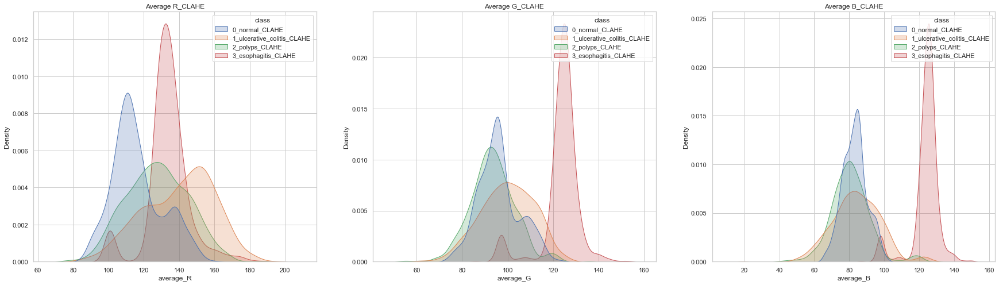

In [17]:
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
sns.kdeplot(data = df_CLAHE, x="average_R", hue="class", fill=True, ax = axes[0]).set_title("Average R_CLAHE")
sns.kdeplot(data = df_CLAHE, x="average_G", hue="class", fill=True, ax = axes[1]).set_title("Average G_CLAHE")
sns.kdeplot(data = df_CLAHE, x="average_B", hue="class", fill=True, ax = axes[2]).set_title("Average B_CLAHE")

# Pixel values are generally higher for esogophitis (this may make it more easily distinguihable) - The most distinct color that distinguishes is the G and B channels
# For normal class, the pixel values are much lower in value and are highly concentrated at that region
# To distinguish between ulverative and polyps, the RED channel may play the biggest role as the average values peak most distinguishabaly for this color channel followed by G and lastly B
# for B channel, it looks like it's very hard to distinguish between the G and B values. 

# The range of values. The R is the highest values from 0 - 255
# G is in the middle
# B is the lowest amongst all 3

Text(0.5, 1.0, '3_esophagitis_CLAHE')

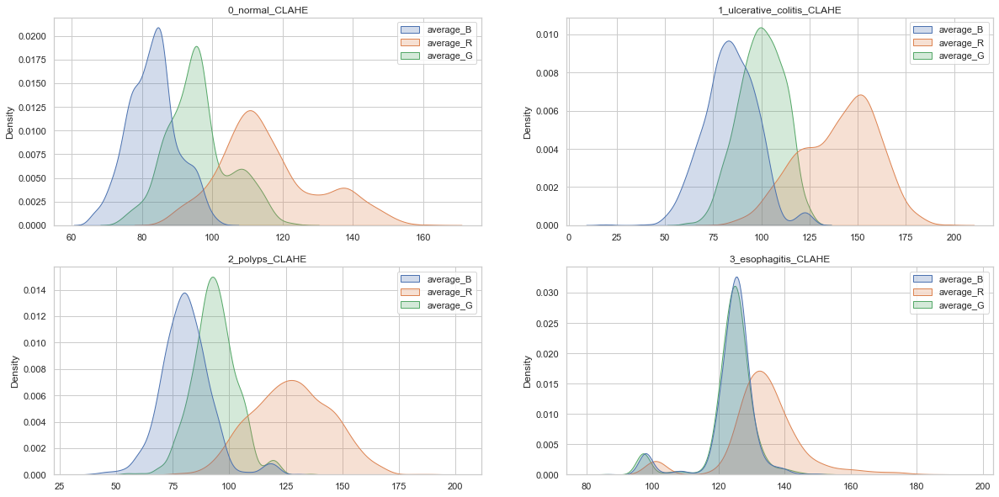

In [18]:
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = df_CLAHE.loc[df_CLAHE["class"] == "0_normal_CLAHE"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("0_normal_CLAHE")

df_normal = df_CLAHE.loc[df_CLAHE["class"] == "1_ulcerative_colitis_CLAHE"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("1_ulcerative_colitis_CLAHE")

df_normal = df_CLAHE.loc[df_CLAHE["class"] == "2_polyps_CLAHE"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("2_polyps_CLAHE")

df_normal = df_CLAHE.loc[df_CLAHE["class"] == "3_esophagitis_CLAHE"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("3_esophagitis_CLAHE")

# Analyse each class on RGB values
# For all you see that the intensity of the RED  is the highest in images for all classes. 

# For normal, the peak of pixel values is at different distinct locations for RGB with the RED being the pixel with highest intensity and Red being the most spread out.  
# The intensity is also the lowest amongst all the other classes

# For ulcerative we observe that the B and G values are more spread out and overlapping but the red is distinctly peaking at a separate location. 
# Pattern remains the same where B and G peak quite sharplu and the red is more spread out
# Its range of values is also higher making it the 2nd highest for all 3 channels when comapred to other classes. 

# For polyps, we see that the B and G peak sharply at 2 different locations, and they are more concentrated at their particular regions. 
# Red on the other hand is more spread out but at a distinct different location
# The intensity of the pixel values are the 3rd highest as compared to the other classes. 

# Lastly for esogophitis. The pixel values for B and G is more spread out but also highly overlapping
# We see that the red channel dominates the entire image. 
# the pixel intensity values are also highest as comapred to the other 3. 
# The values are moderately spread out.

# Exploratory Data Analysis MULTISCALE

In [19]:
# Iterating through each folder in the project data directory
# Base path where data is stored. 
path_data = project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\"
# Walk through data directory
for dirpath, dirnames, filenames in os.walk(path_data):
    if len(filenames) > 0:
      print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")
    
# Analysis shows that the quanitty of images are balanced for each class
# Training image data quantity can be increased by means of data augmentation whcih will be explored further 

There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Multiscale\train\0_normal_MULTISCALE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Multiscale\train\1_ulcerative_colitis_MULTISCALE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Multiscale\train\2_polyps_MULTISCALE'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Multiscale\train\3_esophagitis_MULTISCALE'.


In [20]:
# Get the class names (programmatically, this is much more helpful with a longer list of classes)
data_dir = pathlib.Path(path_data) # turn our training path into a Python path
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectories
print("4 Major Classes are:")
print(class_names)

4 Major Classes are:
['0_normal_MULTISCALE' '1_ulcerative_colitis_MULTISCALE'
 '2_polyps_MULTISCALE' '3_esophagitis_MULTISCALE']


['MULTISCALE_val_normal_ (181).jpg', 'MULTISCALE_train_normal_ (385).jpg', 'MULTISCALE_train_normal_ (128).jpg']
MULTISCALE_val_normal_ (181).jpg
MULTISCALE_train_normal_ (385).jpg
MULTISCALE_train_normal_ (128).jpg


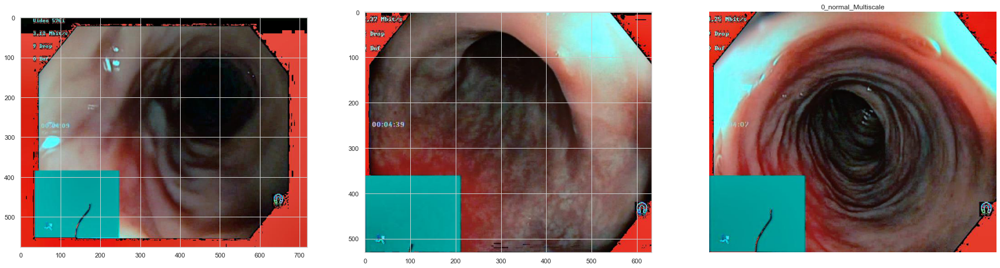

In [21]:
# Plotting images for normal class
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\","0_normal_Multiscale")

['MULTISCALE_train_ulcer_ (73).jpg', 'MULTISCALE_val_ulcer_ (262).jpg', 'MULTISCALE_train_ulcer_ (341).jpg']
MULTISCALE_train_ulcer_ (73).jpg
MULTISCALE_val_ulcer_ (262).jpg
MULTISCALE_train_ulcer_ (341).jpg


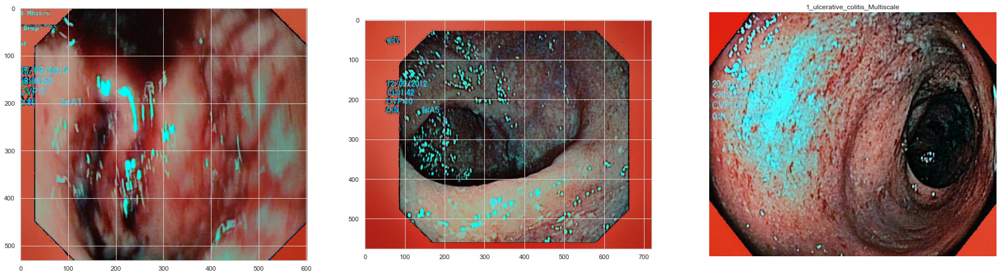

In [22]:
# Plotting images for ulcerative colitis class 
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\","1_ulcerative_colitis_Multiscale")

['MULTISCALE_val_polyps_ (379).jpg', 'MULTISCALE_train_polyps_ (750).jpg', 'MULTISCALE_train_polyps_ (622).jpg']
MULTISCALE_val_polyps_ (379).jpg
MULTISCALE_train_polyps_ (750).jpg
MULTISCALE_train_polyps_ (622).jpg


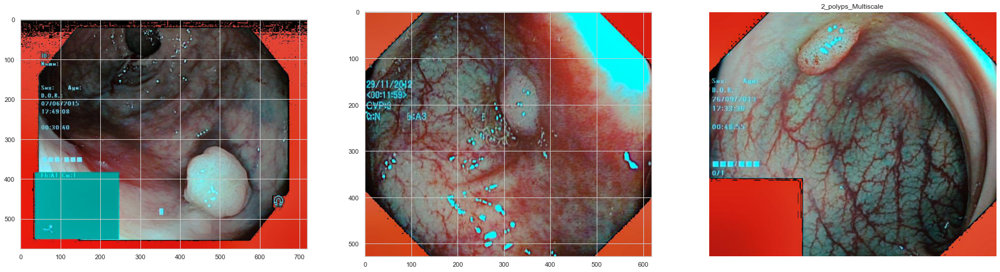

In [23]:
# Plotting images for polyps class 2_polyps
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\","2_polyps_Multiscale")

['MULTISCALE_train_esophagitis_ (374).jpg', 'MULTISCALE_val_esophagitis_ (188).jpg', 'MULTISCALE_train_esophagitis_ (119).jpg']
MULTISCALE_train_esophagitis_ (374).jpg
MULTISCALE_val_esophagitis_ (188).jpg
MULTISCALE_train_esophagitis_ (119).jpg


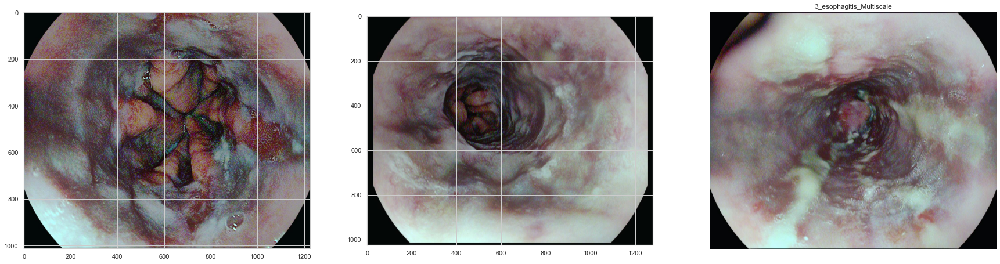

In [24]:
# Plotting images for esophagitis class 3_esophagitis
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\","3_esophagitis_Multiscale")

In [25]:
# Section to create dataframe of image parameters
# Only limited to training image data

# Now we create a .csv file with the contents / metadata from the entire training dataset. 
trainPath = project_folder + "05_Dataset\\Dataset\\Dataset_Multiscale\\train\\"
trainDir = os.listdir(trainPath)
new_df = pd.DataFrame(columns = ['image_id', 'path','class','width','height','channels','average_R','average_G','average_B',"processing_method"])

# Creating the csv file
# Loop through main project directory where training image is stored, gets the image and its parameters and appends it to the df
print("Processing")
for i in range(len(trainDir)):
    listImages = os.listdir(trainPath + trainDir[i])
    for j in range(len(listImages)):
        imageLocation = trainPath + trainDir[i] + "\\" + listImages[j]
        
        tempImage = cv2.imread(imageLocation)
        tempImage = cv2.cvtColor(tempImage, cv2.COLOR_BGR2RGB)
        
        tempHeight, tempWidth, tempChannels = np.shape(tempImage)
        
        tempAverage_R = np.mean(tempImage[:,:,0])
        tempAverage_G = np.mean(tempImage[:,:,1])
        tempAverage_B = np.mean(tempImage[:,:,2])
        
        new_df = new_df.append({'image_id' : listImages[j], 'path' : trainDir[i] + "\\" + listImages[j], 
                                'class': trainDir[i],'width': tempWidth,'height': tempHeight,'channels': tempChannels,
                                'average_R': tempAverage_R,'average_G': tempAverage_G,'average_B':tempAverage_B, "processing_method" : "Multiscale"},ignore_index = True)

print("Processing Done")
# Save dataframe to project directory
# new_df.to_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Multiscale.csv", index = False)

Processing
Processing Done


In [26]:
# Uploading csv file for analysis
df_Multiscale = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Multiscale.csv", index_col = False)
df_Multiscale.head()

,image_id,path,class,width,height,channels,average_R,average_G,average_B,processing_method
0,MULTISCALE_train_normal_ (1).jpg,0_normal_Multiscale\MULTISCALE_train_normal_ (...,0_normal_Multiscale,615,531,3,103.308958,86.145273,80.959429,Multiscale
1,MULTISCALE_train_normal_ (10).jpg,0_normal_Multiscale\MULTISCALE_train_normal_ (...,0_normal_Multiscale,633,531,3,105.122940,91.700166,85.658083,Multiscale
2,MULTISCALE_train_normal_ (100).jpg,0_normal_Multiscale\MULTISCALE_train_normal_ (...,0_normal_Multiscale,633,532,3,110.050372,96.328757,89.709716,Multiscale
3,MULTISCALE_train_normal_ (101).jpg,0_normal_Multiscale\MULTISCALE_train_normal_ (...,0_normal_Multiscale,633,532,3,113.599220,92.644722,86.554520,Multiscale
4,MULTISCALE_train_normal_ (102).jpg,0_normal_Multiscale\MULTISCALE_train_normal_ (...,0_normal_Multiscale,633,532,3,95.151626,80.971472,76.123855,Multiscale


In [27]:
# grouping the data based on their mean, medianm,  min and max height and width parameters
df_groupedMultiscale = df_Multiscale.groupby('class').agg({'width': ['mean',"median",'min', 'max'], 'height': ['mean',"median",'min', 'max']})
df_groupedMultiscale

width                        height  \
                                        mean median  min   max        mean   
class                                                                        
0_normal_Multiscale               686.335238    720  459   720  559.053333   
1_ulcerative_colitis_Multiscale   658.807619    627  482  1920  558.131429   
2_polyps_Multiscale               652.767619    622  332  1920  556.036190   
3_esophagitis_Multiscale         1256.282857   1225  613  1920  998.212381   

                                                   
                                median  min   max  
class                                              
0_normal_Multiscale                576  530   576  
1_ulcerative_colitis_Multiscale    532  447  1080  
2_polyps_Multiscale                531  352  1072  
3_esophagitis_Multiscale          1015  523  1072

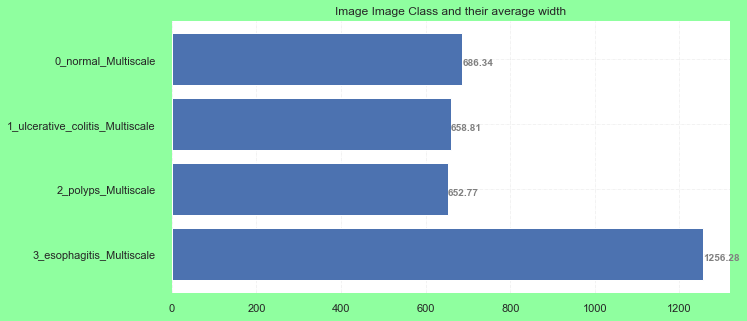

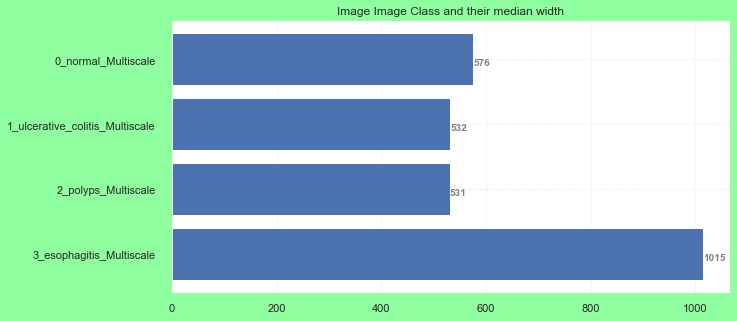

In [28]:
# # Read CSV into pandas 
classes = df_groupedMultiscale.index
avgWidth = df_groupedMultiscale['width']["mean"]
medWidth = df_groupedMultiscale['width']["median"]
avgHeight = df_groupedMultiscale['height']["mean"]
medWidth = df_groupedMultiscale['height']["median"]

plotHorizontalBar(classes,avgWidth,"Image Class","average width")
plotHorizontalBar(classes,medWidth,"Image Class","median width")
# esogophitis class has the biggest image size averaging around 1.2K in average and 1K in median.(consider average)
# Other classes have image size of around 650 on average and 550 in median (i think for this we consider the average)

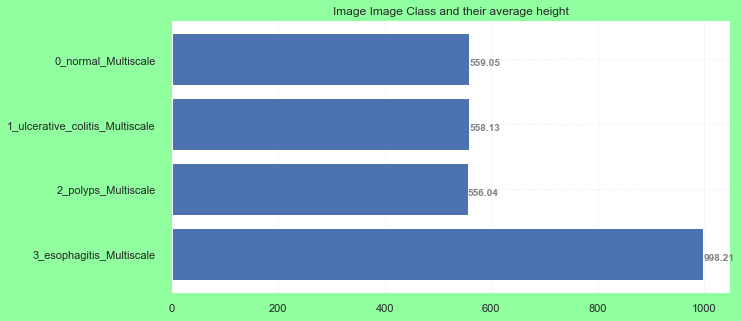

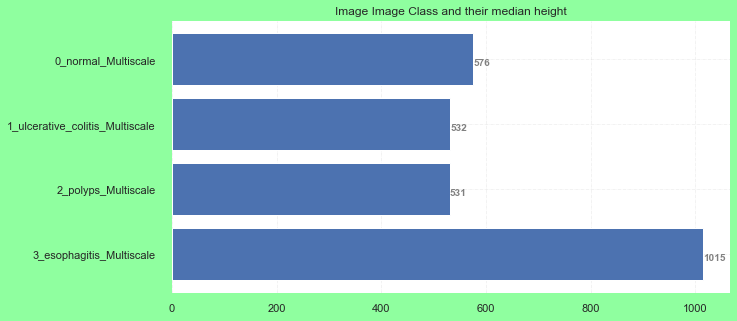

In [29]:
plotHorizontalBar(classes,avgHeight,"Image Class","average height")
plotHorizontalBar(classes,medWidth,"Image Class","median height")

# average height of esogophiotis is around 1K (average) whereas the rest circle around 550
# Median wise the esogophitis is around 1K as well with the rest being around 550

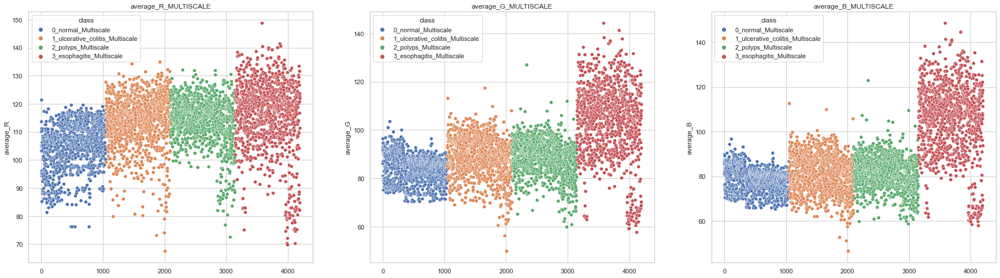

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [30]:
# Plotting for RGB
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(df_Multiscale.index,"average_R","class",df_Multiscale, fig, axes, 0,'average_R_MULTISCALE')
scatterPlot(df_Multiscale.index,"average_G","class",df_Multiscale,fig, axes, 1,'average_G_MULTISCALE')
scatterPlot(df_Multiscale.index,"average_B","class",df_Multiscale,fig, axes, 2,"average_B_MULTISCALE")

# On average, the color spectrum for all 3 is highest for the esogophitis class
# Looking at the green and blue spectrum, we see that the other classes have lower intensities as compare to esogophitis
# For Red color other classes exhibit higher values of pixels
# The normal class has the lowest concentration of pixels for all 3 RGB channels

Text(0.5, 1.0, 'Average B_MULTISCALE')

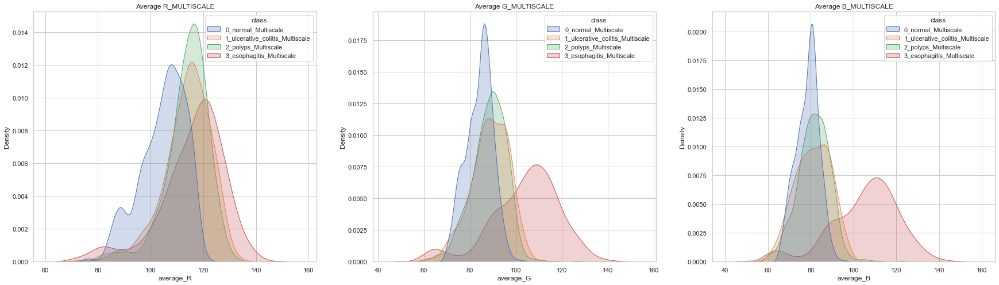

In [31]:
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
sns.kdeplot(data = df_Multiscale, x="average_R", hue="class", fill=True, ax = axes[0]).set_title("Average R_MULTISCALE")
sns.kdeplot(data = df_Multiscale, x="average_G", hue="class", fill=True, ax = axes[1]).set_title("Average G_MULTISCALE")
sns.kdeplot(data = df_Multiscale, x="average_B", hue="class", fill=True, ax = axes[2]).set_title("Average B_MULTISCALE")

# Pixel values are generally higher for esogophitis (this may make it more easily distinguihable) - The most distinct color that distinguishes is the G and B channels
# For normal class, the pixel values are much lower in value and are highly concentrated at that region
# To distinguish between ulverative and polyps, the RED channel may play the biggest role as the average values peak most distinguishabaly for this color channel followed by G and lastly B
# for B channel, it looks like it's very hard to distinguish between the G and B values. 

# The range of values. The R is the highest values from 0 - 255
# G is in the middle
# B is the lowest amongst all 3

Text(0.5, 1.0, '3_esophagitis_MULTISCALE')

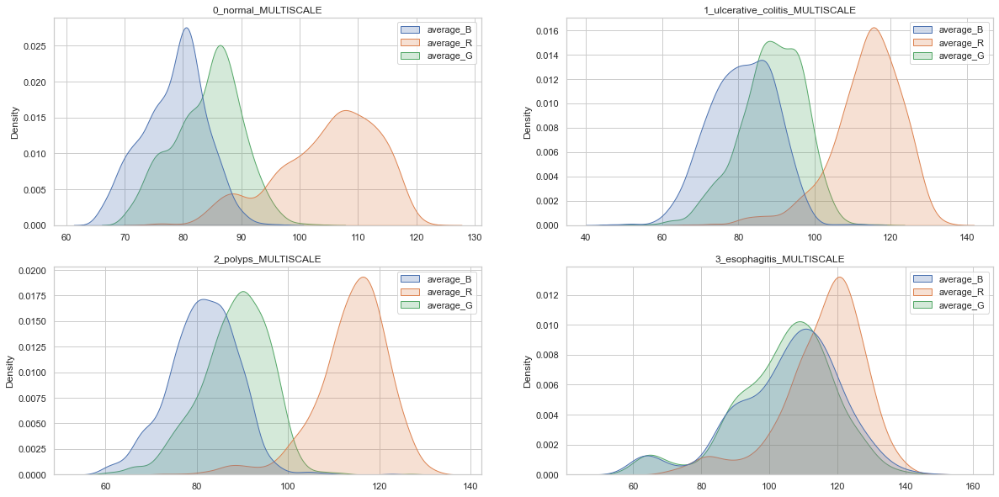

In [32]:
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = df_Multiscale.loc[df_Multiscale["class"] == "0_normal_Multiscale"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("0_normal_MULTISCALE")

df_normal = df_Multiscale.loc[df_Multiscale["class"] == "1_ulcerative_colitis_Multiscale"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("1_ulcerative_colitis_MULTISCALE")

df_normal = df_Multiscale.loc[df_Multiscale["class"] == "2_polyps_Multiscale"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("2_polyps_MULTISCALE")

df_normal = df_Multiscale.loc[df_Multiscale["class"] == "3_esophagitis_Multiscale"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("3_esophagitis_MULTISCALE")

# Analyse each class on RGB values
# For all you see that the intensity of the RED  is the highest in images for all classes. 

# For normal, the peak of pixel values is at different distinct locations for RGB with the RED being the pixel with highest intensity and Red being the most spread out.  
# The intensity is also the lowest amongst all the other classes

# For ulcerative we observe that the B and G values are more spread out and overlapping but the red is distinctly peaking at a separate location. 
# Pattern remains the same where B and G peak quite sharplu and the red is more spread out
# Its range of values is also higher making it the 2nd highest for all 3 channels when comapred to other classes. 

# For polyps, we see that the B and G peak sharply at 2 different locations, and they are more concentrated at their particular regions. 
# Red on the other hand is more spread out but at a distinct different location
# The intensity of the pixel values are the 3rd highest as compared to the other classes. 

# Lastly for esogophitis. The pixel values for B and G is more spread out but also highly overlapping
# We see that the red channel dominates the entire image. 
# the pixel intensity values are also highest as comapred to the other 3. 
# The values are moderately spread out.

# Exploratory Data Analysis RAYLEIGH

In [33]:
# Iterating through each folder in the project data directory
# Base path where data is stored. 
path_data = project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\"
# Walk through data directory
for dirpath, dirnames, filenames in os.walk(path_data):
    if len(filenames) > 0:
      print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")
    
# Analysis shows that the quanitty of images are balanced for each class
# Training image data quantity can be increased by means of data augmentation whcih will be explored further 

There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Rayleigh\train\0_normal_RAYLEIGH'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Rayleigh\train\1_ulcerative_colitis_RAYLEIGH'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Rayleigh\train\2_polyps_RAYLEIGH'.
There are 0 directories and 1050 images in 'C:\Users\User\Documents\Masters in AI\GITractClassification\05_Dataset\Dataset\Dataset_Rayleigh\train\3_esophagitis_RAYLEIGH'.


In [34]:
# Get the class names (programmatically, this is much more helpful with a longer list of classes)
data_dir = pathlib.Path(path_data) # turn our training path into a Python path
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectories
print("4 Major Classes are:")
print(class_names)

4 Major Classes are:
['0_normal_RAYLEIGH' '1_ulcerative_colitis_RAYLEIGH' '2_polyps_RAYLEIGH'
 '3_esophagitis_RAYLEIGH']


['RAYLEIGH_train_normal_ (679).jpg', 'RAYLEIGH_val_normal_ (208).jpg', 'RAYLEIGH_val_normal_ (169).jpg']
RAYLEIGH_train_normal_ (679).jpg
RAYLEIGH_val_normal_ (208).jpg
RAYLEIGH_val_normal_ (169).jpg


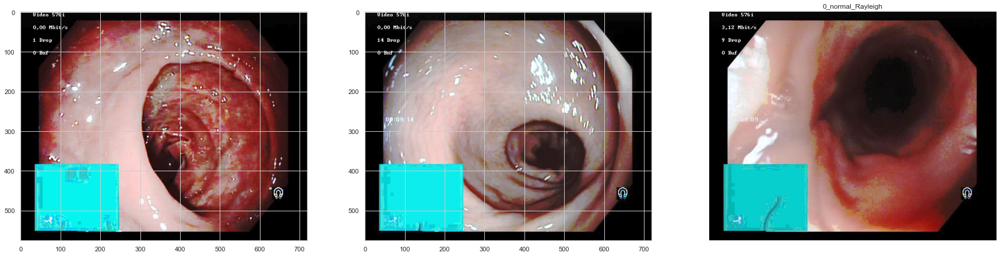

In [35]:
# Plotting images for normal class
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\","0_normal_Rayleigh")

['RAYLEIGH_train_ulcer_ (19).jpg', 'RAYLEIGH_train_ulcer_ (437).jpg', 'RAYLEIGH_train_ulcer_ (312).jpg']
RAYLEIGH_train_ulcer_ (19).jpg
RAYLEIGH_train_ulcer_ (437).jpg
RAYLEIGH_train_ulcer_ (312).jpg


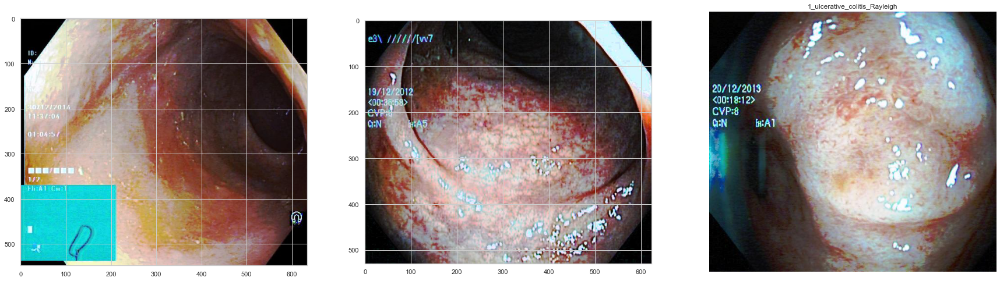

In [36]:
# Plotting images for ulcerative colitis class 
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\","1_ulcerative_colitis_Rayleigh")

['RAYLEIGH_val_polyps_ (171).jpg', 'RAYLEIGH_train_polyps_ (56).jpg', 'RAYLEIGH_train_polyps_ (748).jpg']
RAYLEIGH_val_polyps_ (171).jpg
RAYLEIGH_train_polyps_ (56).jpg
RAYLEIGH_train_polyps_ (748).jpg


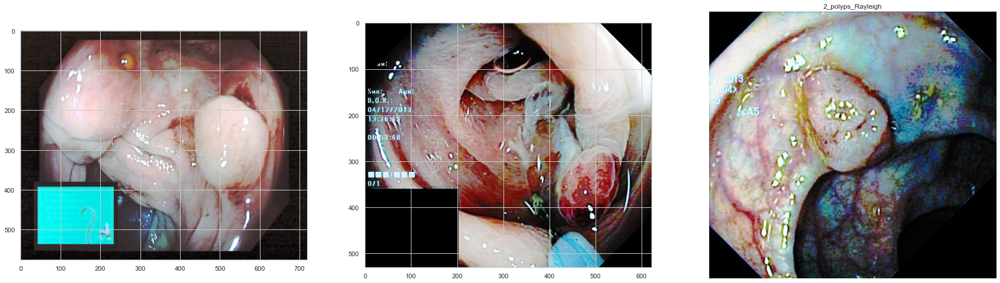

In [37]:
# Plotting images for polyps class 2_polyps
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\","2_polyps_Rayleigh")

['RAYLEIGH_val_esophagitis_ (212).jpg', 'RAYLEIGH_train_esophagitis_ (55).jpg', 'RAYLEIGH_train_esophagitis_ (580).jpg']
RAYLEIGH_val_esophagitis_ (212).jpg
RAYLEIGH_train_esophagitis_ (55).jpg
RAYLEIGH_train_esophagitis_ (580).jpg


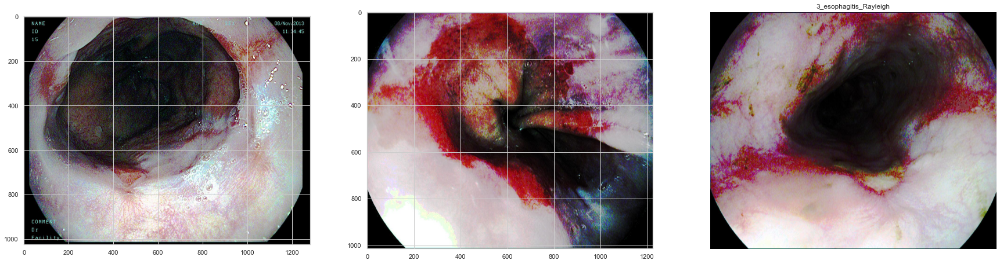

In [38]:
# Plotting images for esophagitis class 3_esophagitis
view_random_image(project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\","3_esophagitis_Rayleigh")

In [39]:
# Section to create dataframe of image parameters
# Only limited to training image data
# Now we create a .csv file with the contents / metadata from the entire training dataset. 
trainPath = project_folder + "05_Dataset\\Dataset\\Dataset_Rayleigh\\train\\"
trainDir = os.listdir(trainPath)
new_df = pd.DataFrame(columns = ['image_id', 'path','class','width','height','channels','average_R','average_G','average_B',"processing_method"])

# Creating the csv file
# Loop through main project directory where training image is stored, gets the image and its parameters and appends it to the df
print("Processing")
for i in range(len(trainDir)):
    listImages = os.listdir(trainPath + trainDir[i])
    for j in range(len(listImages)):
        imageLocation = trainPath + trainDir[i] + "\\" + listImages[j]
        
        tempImage = cv2.imread(imageLocation)
        tempImage = cv2.cvtColor(tempImage, cv2.COLOR_BGR2RGB)
        
        tempHeight, tempWidth, tempChannels = np.shape(tempImage)
        
        tempAverage_R = np.mean(tempImage[:,:,0])
        tempAverage_G = np.mean(tempImage[:,:,1])
        tempAverage_B = np.mean(tempImage[:,:,2])
        
        new_df = new_df.append({'image_id' : listImages[j], 'path' : trainDir[i] + "\\" + listImages[j], 
                                'class': trainDir[i],'width': tempWidth,'height': tempHeight,'channels': tempChannels,
                                'average_R': tempAverage_R,'average_G': tempAverage_G,'average_B':tempAverage_B, "processing_method": "Rayleigh"},ignore_index = True)

print("Processing Done")        
# Save dataframe to project directory
# new_df.to_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Rayleigh.csv", index = False)

Processing
Processing Done


In [40]:
# Uploading csv file for analysis
df_Rayleigh = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Rayleigh.csv", index_col = False)
df_Rayleigh.head()

,image_id,path,class,width,height,channels,average_R,average_G,average_B,processing_method
0,RAYLEIGH_train_normal_ (1).jpg,0_normal_Rayleigh\RAYLEIGH_train_normal_ (1).jpg,0_normal_Rayleigh,615,531,3,122.277764,120.037708,119.861023,Rayleigh
1,RAYLEIGH_train_normal_ (10).jpg,0_normal_Rayleigh\RAYLEIGH_train_normal_ (10).jpg,0_normal_Rayleigh,633,531,3,121.805006,104.005317,100.922475,Rayleigh
2,RAYLEIGH_train_normal_ (100).jpg,0_normal_Rayleigh\RAYLEIGH_train_normal_ (100)...,0_normal_Rayleigh,633,532,3,120.734526,114.198289,110.391399,Rayleigh
3,RAYLEIGH_train_normal_ (101).jpg,0_normal_Rayleigh\RAYLEIGH_train_normal_ (101)...,0_normal_Rayleigh,633,532,3,128.241041,127.771490,126.986020,Rayleigh
4,RAYLEIGH_train_normal_ (102).jpg,0_normal_Rayleigh\RAYLEIGH_train_normal_ (102)...,0_normal_Rayleigh,633,532,3,122.937533,98.466733,97.073962,Rayleigh


In [41]:
# grouping the data based on their mean, medianm,  min and max height and width parameters
df_groupedRayleigh = df_Rayleigh.groupby('class').agg({'width': ['mean',"median",'min', 'max'], 'height': ['mean',"median",'min', 'max']})
df_groupedRayleigh

width                        height  \
                                      mean median  min   max        mean   
class                                                                      
0_normal_Rayleigh               686.335238    720  459   720  559.053333   
1_ulcerative_colitis_Rayleigh   658.807619    627  482  1920  558.131429   
2_polyps_Rayleigh               652.767619    622  332  1920  556.036190   
3_esophagitis_Rayleigh         1256.282857   1225  613  1920  998.212381   

                                                 
                              median  min   max  
class                                            
0_normal_Rayleigh                576  530   576  
1_ulcerative_colitis_Rayleigh    532  447  1080  
2_polyps_Rayleigh                531  352  1072  
3_esophagitis_Rayleigh          1015  523  1072

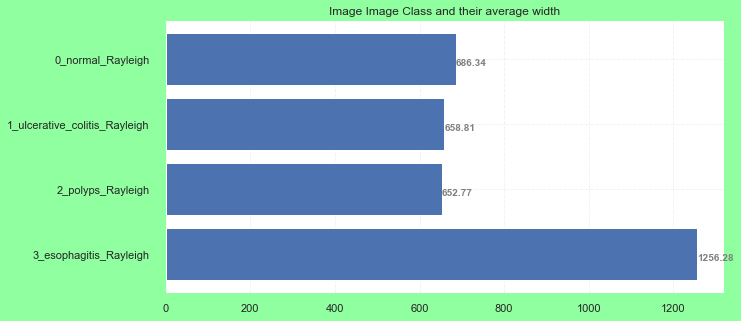

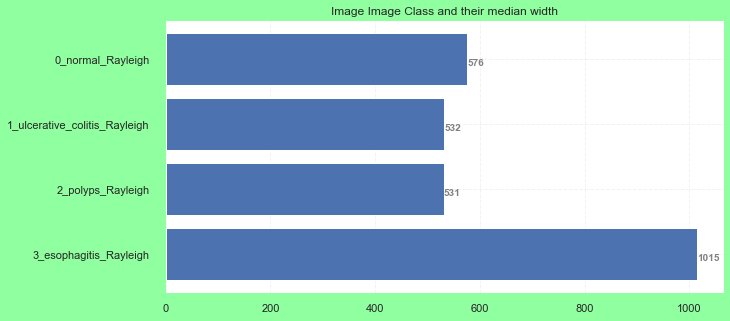

In [42]:
# # Read CSV into pandas 
classes = df_groupedRayleigh.index
avgWidth = df_groupedRayleigh['width']["mean"]
medWidth = df_groupedRayleigh['width']["median"]
avgHeight = df_groupedRayleigh['height']["mean"]
medWidth = df_groupedRayleigh['height']["median"]

plotHorizontalBar(classes,avgWidth,"Image Class","average width")
plotHorizontalBar(classes,medWidth,"Image Class","median width")

# esogophitis class has the biggest image size averaging around 1.2K in average and 1K in median.(consider average)
# Other classes have image size of around 650 on average and 550 in median (i think for this we consider the average)

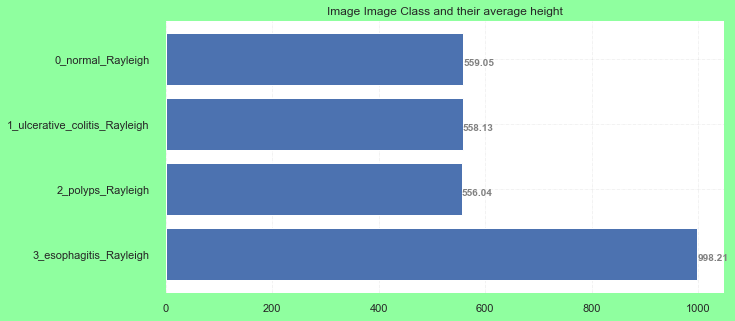

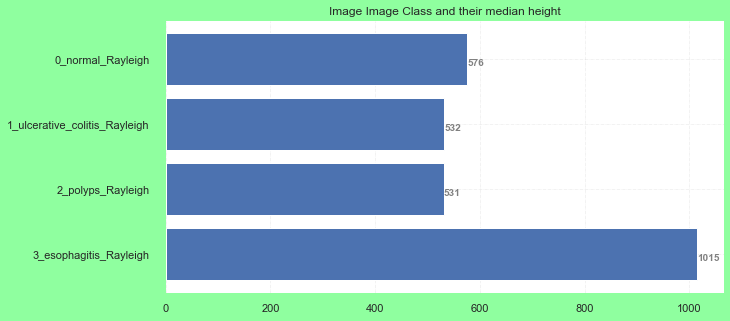

In [43]:
plotHorizontalBar(classes,avgHeight,"Image Class","average height")
plotHorizontalBar(classes,medWidth,"Image Class","median height")

# average height of esogophiotis is around 1K (average) whereas the rest circle around 550
# Median wise the esogophitis is around 1K as well with the rest being around 550

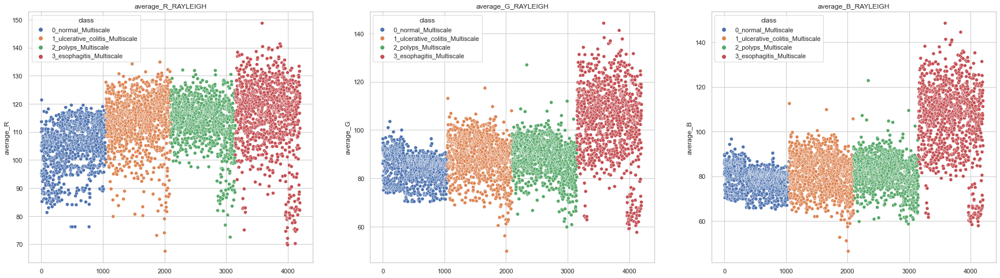

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [44]:
# Plotting for RGB
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(df_Rayleigh.index,"average_R","class",df_Multiscale, fig, axes, 0,'average_R_RAYLEIGH')
scatterPlot(df_Rayleigh.index,"average_G","class",df_Multiscale,fig, axes, 1,'average_G_RAYLEIGH')
scatterPlot(df_Rayleigh.index,"average_B","class",df_Multiscale,fig, axes, 2,"average_B_RAYLEIGH")

# On average, the color spectrum for all 3 is highest for the esogophitis class
# Looking at the green and blue spectrum, we see that the other classes have lower intensities as compare to esogophitis
# For Red color other classes exhibit higher values of pixels
# The normal class has the lowest concentration of pixels for all 3 RGB channels

Text(0.5, 1.0, 'Average B_RAYLEIGH')

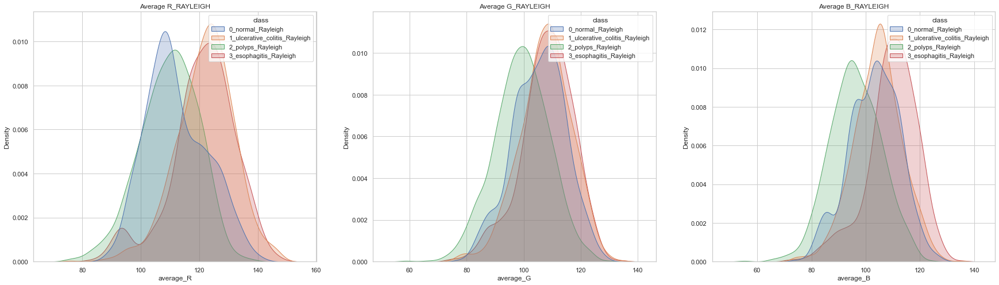

In [45]:
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
sns.kdeplot(data = df_Rayleigh, x="average_R", hue="class", fill=True, ax = axes[0]).set_title("Average R_RAYLEIGH")
sns.kdeplot(data = df_Rayleigh, x="average_G", hue="class", fill=True, ax = axes[1]).set_title("Average G_RAYLEIGH")
sns.kdeplot(data = df_Rayleigh, x="average_B", hue="class", fill=True, ax = axes[2]).set_title("Average B_RAYLEIGH")

# Pixel values are generally higher for esogophitis (this may make it more easily distinguihable) - The most distinct color that distinguishes is the G and B channels
# For normal class, the pixel values are much lower in value and are highly concentrated at that region
# To distinguish between ulverative and polyps, the RED channel may play the biggest role as the average values peak most distinguishabaly for this color channel followed by G and lastly B
# for B channel, it looks like it's very hard to distinguish between the G and B values. 

# The range of values. The R is the highest values from 0 - 255
# G is in the middle
# B is the lowest amongst all 3

Text(0.5, 1.0, '3_esophagitis_RAYLEIGH')

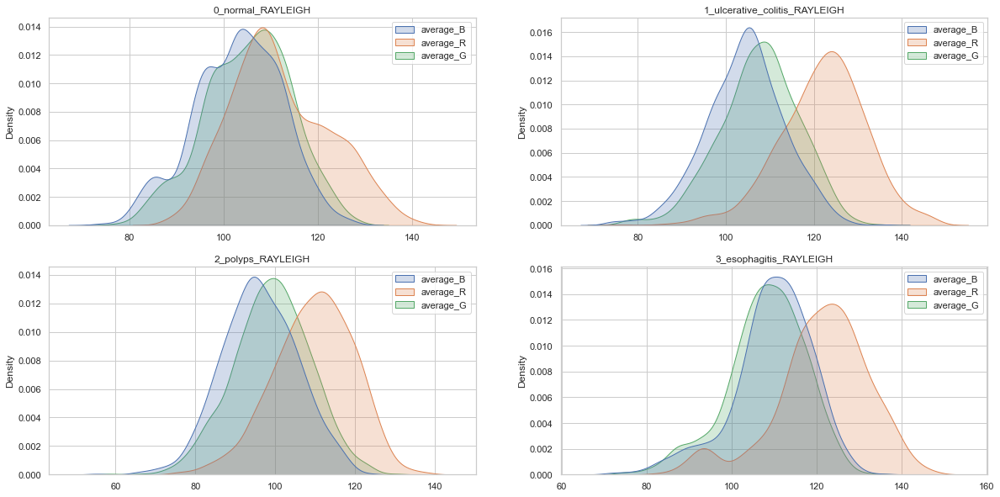

In [46]:
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = df_Rayleigh.loc[df_Rayleigh["class"] == "0_normal_Rayleigh"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("0_normal_RAYLEIGH")

df_normal = df_Rayleigh.loc[df_Rayleigh["class"] == "1_ulcerative_colitis_Rayleigh"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("1_ulcerative_colitis_RAYLEIGH")

df_normal = df_Rayleigh.loc[df_Rayleigh["class"] == "2_polyps_Rayleigh"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("2_polyps_RAYLEIGH")

df_normal = df_Rayleigh.loc[df_Rayleigh["class"] == "3_esophagitis_Rayleigh"][["average_B","average_R","average_G"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("3_esophagitis_RAYLEIGH")

# Analyse each class on RGB values
# For all you see that the intensity of the RED  is the highest in images for all classes. 

# For normal, the peak of pixel values is at different distinct locations for RGB with the RED being the pixel with highest intensity and Red being the most spread out.  
# The intensity is also the lowest amongst all the other classes

# For ulcerative we observe that the B and G values are more spread out and overlapping but the red is distinctly peaking at a separate location. 
# Pattern remains the same where B and G peak quite sharplu and the red is more spread out
# Its range of values is also higher making it the 2nd highest for all 3 channels when comapred to other classes. 

# For polyps, we see that the B and G peak sharply at 2 different locations, and they are more concentrated at their particular regions. 
# Red on the other hand is more spread out but at a distinct different location
# The intensity of the pixel values are the 3rd highest as compared to the other classes. 

# Lastly for esogophitis. The pixel values for B and G is more spread out but also highly overlapping
# We see that the red channel dominates the entire image. 
# the pixel intensity values are also highest as comapred to the other 3. 
# The values are moderately spread out.

# Analysing Image Processsed Data

In [47]:
# Dataset containing results of PSNR, MSE and SSIM for all three enhancement techniques for each image
dfIPCV = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysisIPCV_Comparison.csv")

# Dataset containing data of image proces enhanced data. 
df_CLAHE = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_CLAHE.csv")
df_Multiscale = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Multiscale.csv")
df_Rayleigh = pd.read_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\trainDataAnalysis_Rayleigh.csv")

In [48]:
dfIPCV

,image_id,path,class,width,height,channels,average_R,average_G,average_B,PSNR_CLAHE,SSIM_CLAHE,MSE_CLAHE,PSNR_MULTISCALE,SSIM_MULTISCALE,MSE_MULTISCALE,PSNR_RAYLEIGH,SSIM_RAYLEIGH,MSE_RAYLEIGH
0,train_normal_ (1).jpg,0_normal\train_normal_ (1).jpg,0_normal,615,531,3,137.630346,87.531594,69.068691,21.622330,0.850518,447.555948,15.111905,0.778601,2003.963801,14.837695,0.839029,2134.572491
1,train_normal_ (10).jpg,0_normal\train_normal_ (10).jpg,0_normal,633,531,3,141.796705,96.659800,74.475838,21.226577,0.836770,490.255765,14.452678,0.781771,2332.451328,18.076784,0.853369,1012.516131
2,train_normal_ (100).jpg,0_normal\train_normal_ (100).jpg,0_normal,633,532,3,144.548750,106.395343,80.402570,22.080174,0.861495,402.775467,14.635381,0.780592,2236.362924,16.288995,0.806785,1528.202268
3,train_normal_ (101).jpg,0_normal\train_normal_ (101).jpg,0_normal,633,532,3,155.410680,99.276625,75.801441,22.012171,0.868816,409.131863,14.129329,0.803406,2512.739550,14.225392,0.834579,2457.769677
4,train_normal_ (102).jpg,0_normal\train_normal_ (102).jpg,0_normal,633,532,3,119.790816,79.526503,61.595505,21.031905,0.836877,512.731326,15.553833,0.773458,1810.077128,16.458471,0.808057,1469.715590
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4195,val_esophagitis_ (396).jpg,3_esophagitis\val_esophagitis_ (396).jpg,3_esophagitis,1280,1024,3,178.159901,144.082242,144.554438,14.097078,0.561356,2531.468823,15.317266,0.845241,1911.409754,14.134730,0.672039,2509.616734
4196,val_esophagitis_ (397).jpg,3_esophagitis\val_esophagitis_ (397).jpg,3_esophagitis,1280,1024,3,163.906477,119.976292,125.512279,14.592328,0.442465,2258.642996,12.017105,0.706083,4086.672545,14.683705,0.687339,2211.616538
4197,val_esophagitis_ (398).jpg,3_esophagitis\val_esophagitis_ (398).jpg,3_esophagitis,1920,1072,3,119.892404,83.642191,80.549055,15.207866,0.637856,1960.170244,18.189289,0.745665,986.623547,19.469822,0.606005,734.679980
4198,val_esophagitis_ (399).jpg,3_esophagitis\val_esophagitis_ (399).jpg,3_esophagitis,1280,1024,3,179.591132,132.178719,140.886704,13.716623,0.447151,2763.236259,14.909023,0.809151,2099.800798,14.574514,0.599021,2267.926517


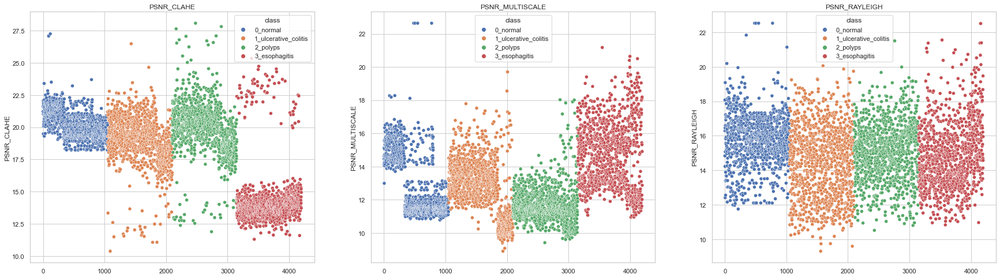

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [49]:
def scatterPlot(x,y,hue,dataset, figure, axes, position, title):
    """
    SNS scatterplot function to plot the average RGB values for training iamges for visualization
    """
    import seaborn
    seaborn.set(style='whitegrid')
    plt.figure(figsize = (10,5))
    seaborn.scatterplot(x=x,
                        y=y,
                        hue=hue,
                        data=dataset, ax = axes[position]).set_title(title)

# Plotting the PSNR for each class and each enhancement technique
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(dfIPCV.index,"PSNR_CLAHE","class",dfIPCV, fig, axes, 0,'PSNR_CLAHE')
scatterPlot(dfIPCV.index,"PSNR_MULTISCALE","class",dfIPCV,fig, axes, 1,'PSNR_MULTISCALE')
scatterPlot(dfIPCV.index,"PSNR_RAYLEIGH","class",dfIPCV,fig, axes, 2,"PSNR_RAYLEIGH")

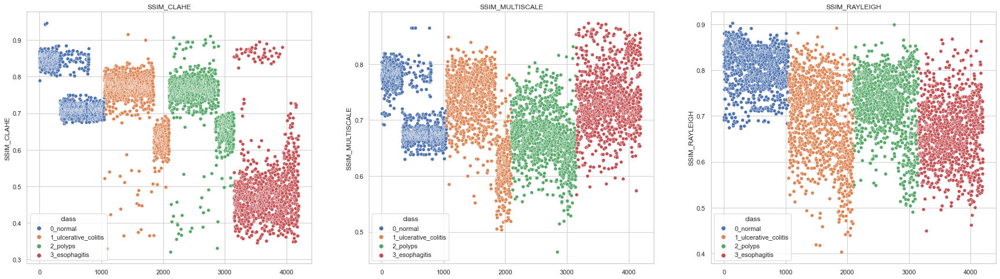

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [50]:
# Plotting the SSIM for each class and each enhancement technique
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(dfIPCV.index,"SSIM_CLAHE","class",dfIPCV, fig, axes, 0,'SSIM_CLAHE')
scatterPlot(dfIPCV.index,"SSIM_MULTISCALE","class",dfIPCV,fig, axes, 1,'SSIM_MULTISCALE')
scatterPlot(dfIPCV.index,"SSIM_RAYLEIGH","class",dfIPCV,fig, axes, 2,"SSIM_RAYLEIGH")

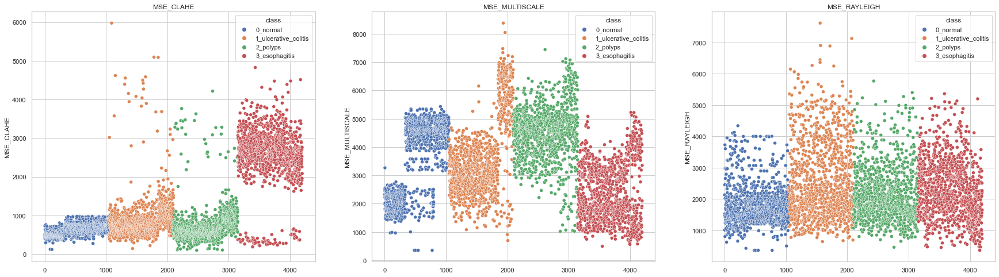

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

<Figure size 720x360 with 0 Axes>

In [51]:
# Plotting the MSE for each class and each enhancement technique
fig, axes = plt.subplots(figsize=(30,8), ncols=3, nrows=1)
scatterPlot(dfIPCV.index,"MSE_CLAHE","class",dfIPCV, fig, axes, 0,'MSE_CLAHE')
scatterPlot(dfIPCV.index,"MSE_MULTISCALE","class",dfIPCV,fig, axes, 1,'MSE_MULTISCALE')
scatterPlot(dfIPCV.index,"MSE_RAYLEIGH","class",dfIPCV,fig, axes, 2,"MSE_RAYLEIGH")

Text(0.5, 1.0, 'PSNR 3_esophagitis')

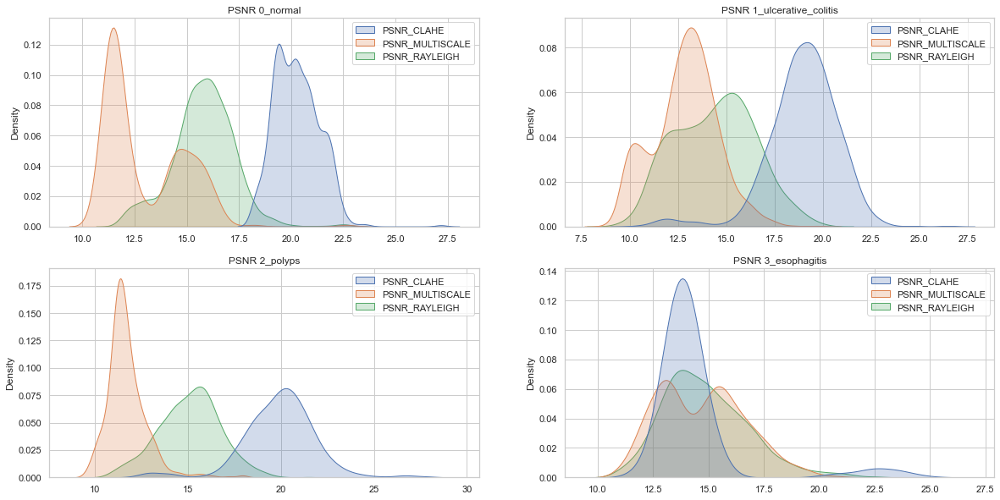

In [52]:
# Plotting PSNR Distriubtion for each class against different enhancement techniques
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = dfIPCV.loc[dfIPCV["class"] == "0_normal"][["PSNR_CLAHE","PSNR_MULTISCALE","PSNR_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("PSNR 0_normal")

df_normal = dfIPCV.loc[dfIPCV["class"] == "1_ulcerative_colitis"][["PSNR_CLAHE","PSNR_MULTISCALE","PSNR_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("PSNR 1_ulcerative_colitis")

df_normal = dfIPCV.loc[dfIPCV["class"] == "2_polyps"][["PSNR_CLAHE","PSNR_MULTISCALE","PSNR_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("PSNR 2_polyps")

df_normal = dfIPCV.loc[dfIPCV["class"] == "3_esophagitis"][["PSNR_CLAHE","PSNR_MULTISCALE","PSNR_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("PSNR 3_esophagitis")

Text(0.5, 1.0, 'SSIM 3_esophagitis')

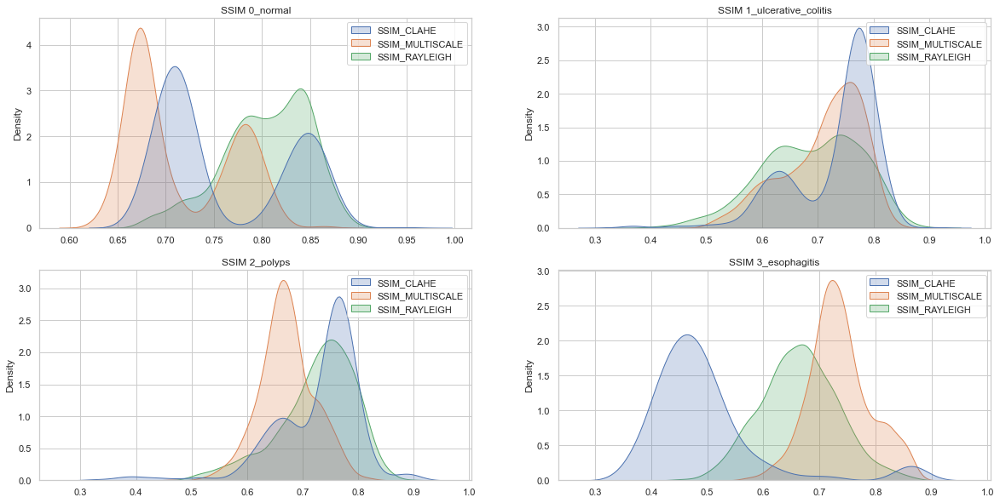

In [53]:
# Plotting SSIM Distriubtion for each class against different enhancement techniques
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = dfIPCV.loc[dfIPCV["class"] == "0_normal"][["SSIM_CLAHE","SSIM_MULTISCALE","SSIM_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("SSIM 0_normal")

df_normal = dfIPCV.loc[dfIPCV["class"] == "1_ulcerative_colitis"][["SSIM_CLAHE","SSIM_MULTISCALE","SSIM_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("SSIM 1_ulcerative_colitis")

df_normal = dfIPCV.loc[dfIPCV["class"] == "2_polyps"][["SSIM_CLAHE","SSIM_MULTISCALE","SSIM_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("SSIM 2_polyps")

df_normal = dfIPCV.loc[dfIPCV["class"] == "3_esophagitis"][["SSIM_CLAHE","SSIM_MULTISCALE","SSIM_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("SSIM 3_esophagitis")

Text(0.5, 1.0, 'MSE 3_esophagitis')

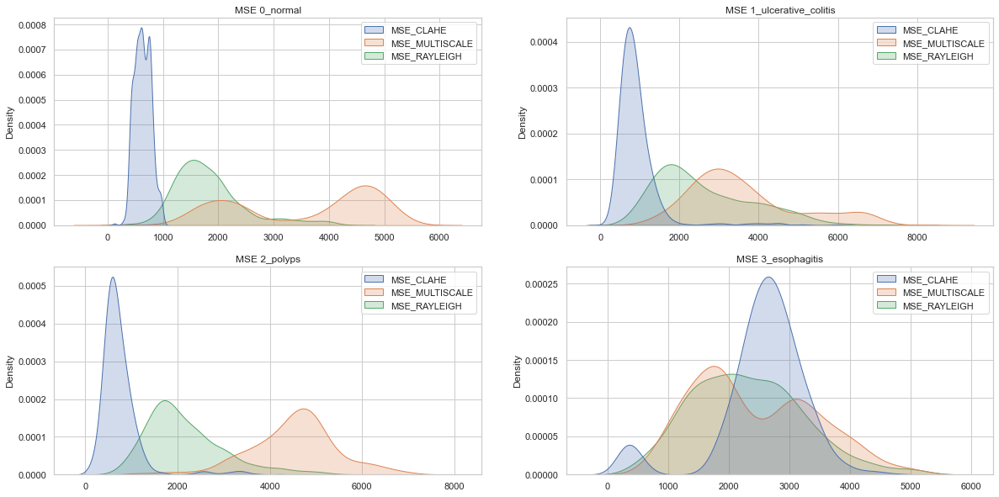

In [54]:
# Plotting SSIM Distriubtion for each class against different enhancement techniques
fig, axes = plt.subplots(figsize=(20,10), ncols=2, nrows=2)

df_normal = dfIPCV.loc[dfIPCV["class"] == "0_normal"][["MSE_CLAHE","MSE_MULTISCALE","MSE_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True,ax = axes[0,0]).set_title("MSE 0_normal")

df_normal = dfIPCV.loc[dfIPCV["class"] == "1_ulcerative_colitis"][["MSE_CLAHE","MSE_MULTISCALE","MSE_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[0,1]).set_title("MSE 1_ulcerative_colitis")

df_normal = dfIPCV.loc[dfIPCV["class"] == "2_polyps"][["MSE_CLAHE","MSE_MULTISCALE","MSE_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,0]).set_title("MSE 2_polyps")

df_normal = dfIPCV.loc[dfIPCV["class"] == "3_esophagitis"][["MSE_CLAHE","MSE_MULTISCALE","MSE_RAYLEIGH"]]
sns.kdeplot(data=df_normal,fill=True, ax = axes[1,1]).set_title("MSE 3_esophagitis")

In [55]:
# grouping the data based on their mean, median,  min and max height and width parameters
dfIPCV_grouped = dfIPCV.groupby('class').agg({'PSNR_CLAHE': ['mean',"median",'std'], 'PSNR_MULTISCALE': ['mean',"median",'std'], 'PSNR_RAYLEIGH': ['mean',"median",'std'],
                                             'SSIM_CLAHE': ['mean',"median",'std'],'SSIM_MULTISCALE': ['mean',"median",'std'],'SSIM_RAYLEIGH': ['mean',"median",'std'],
                                             'MSE_CLAHE': ['mean',"median",'std'],'MSE_MULTISCALE': ['mean',"median",'std'],'MSE_RAYLEIGH': ['mean',"median",'std']})
# dfIPCV_grouped.to_csv(project_folder + "02_ImageProcessingExperimentation\\ImageProcessingResults\\01_csvFiles\\dfIPCV_grouped.csv")

In [56]:
dfIPCV_grouped

PSNR_CLAHE                      PSNR_MULTISCALE  \
                           mean     median       std            mean   
class                                                                  
0_normal              20.262680  20.192330  1.070183       12.978562   
1_ulcerative_colitis  18.965633  19.129788  1.844516       12.860642   
2_polyps              19.914749  20.037275  2.016963       11.701787   
3_esophagitis         14.385287  13.884663  2.239359       14.697118   

                                          PSNR_RAYLEIGH                       \
                         median       std          mean     median       std   
class                                                                          
0_normal              11.945195  1.911033     15.778024  15.848445  1.486211   
1_ulcerative_colitis  12.967025  1.663125     14.415035  14.512648  2.054844   
2_polyps              11.510627  1.079177     15.091440  15.177000  1.653446   
3_esophagitis         14.751349  1.949905     14.873594  14.618367  1.930620   

                     SSIM_CLAHE  ... SSIM_RAYLEIGH    MSE_CLAHE               \
                           mean  ...           std         mean       median   
class                            ...                                           
0_normal               0.760750  ...      0.044842   629.965324   622.081674   
1_ulcerative_colitis   0.730804  ...      0.087643   920.306324   794.514114   
2_polyps               0.727920  ...      0.068595   748.368894   644.692913   
3_esophagitis          0.492881  ...      0.068493  2576.536941  2658.361422   

                                 MSE_MULTISCALE                            \
                             std           mean       median          std   
class                                                                       
0_normal              146.511187    3562.548653  4154.902268  1296.224424   
1_ulcerative_colitis  585.489921    3619.352579  3283.809029  1411.189356   
2_polyps              474.001951    4515.129158  4592.166838   959.949862   
3_esophagitis         728.031205    2423.514324  2177.436181  1014.083555   

                     MSE_RAYLEIGH                            
                             mean       median          std  
class                                                        
0_normal              1822.328673  1691.359205   649.892177  
1_ulcerative_colitis  2625.628823  2300.464933  1240.731072  
2_polyps              2165.772012  1974.151222   861.130173  
3_esophagitis         2314.239105  2245.141056   922.378606  

[4 rows x 27 columns]